In [1]:
import numpy as np
import cv2, PIL, os
from cv2 import aruco
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
%matplotlib nbagg

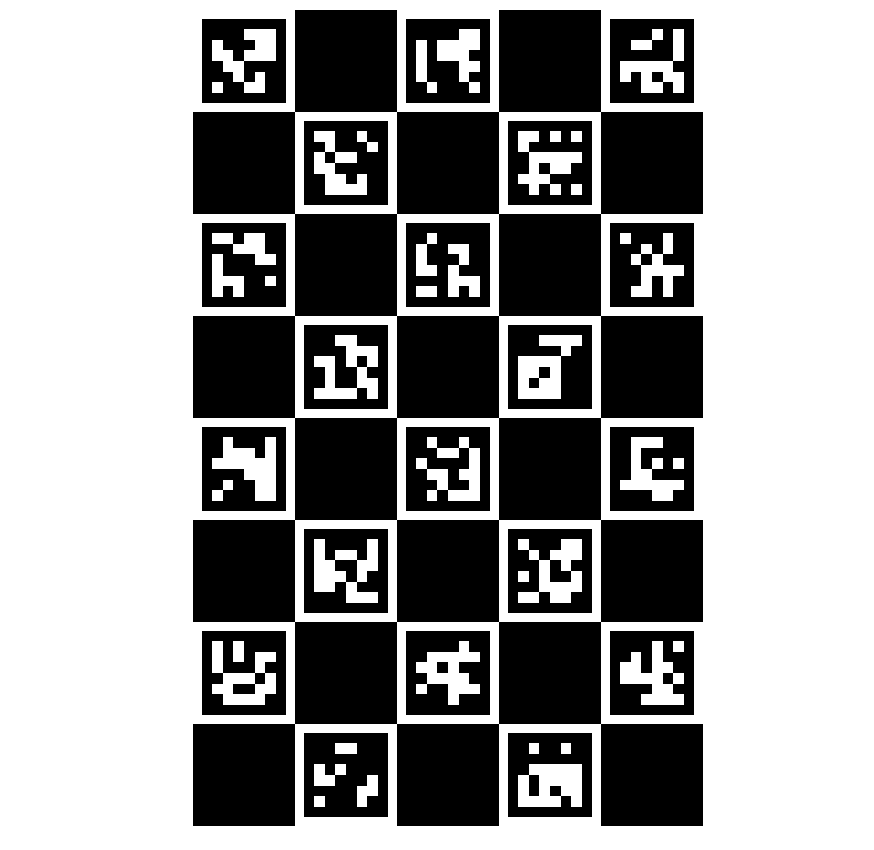

In [2]:
workdir = "./workdir/"
aruco_dict = aruco.Dictionary_get(aruco.DICT_6X6_250)
board = aruco.CharucoBoard_create(5, 8, 3.7, 3.075, aruco_dict)
imboard = board.draw((2000, 2000))
# cv2.imwrite(workdir + "chessboard.tiff", imboard)
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(1,1,1)
plt.imshow(imboard, cmap = mpl.cm.gray, interpolation = "nearest")
ax.axis("off")
plt.show()

In [3]:
datadir = "pic/"
images = np.array([datadir + f for f in os.listdir(datadir) if f.endswith(".jpg") ])
order = np.argsort([int(p.split(".")[-2].split("/")[-1]) for p in images])
images = images[order]
images

array(['pic/1.jpg', 'pic/2.jpg', 'pic/3.jpg', 'pic/4.jpg', 'pic/5.jpg',
       'pic/6.jpg', 'pic/7.jpg', 'pic/8.jpg', 'pic/9.jpg', 'pic/10.jpg',
       'pic/11.jpg', 'pic/12.jpg', 'pic/13.jpg', 'pic/14.jpg',
       'pic/15.jpg', 'pic/16.jpg', 'pic/17.jpg', 'pic/18.jpg',
       'pic/19.jpg', 'pic/20.jpg', 'pic/21.jpg', 'pic/22.jpg',
       'pic/23.jpg', 'pic/24.jpg', 'pic/25.jpg', 'pic/26.jpg',
       'pic/27.jpg', 'pic/28.jpg'], dtype='<U10')

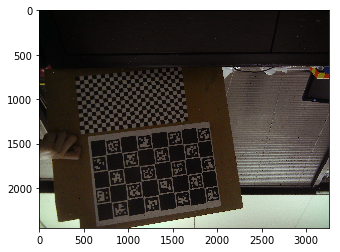

In [4]:
im = PIL.Image.open(images[0])
fig = plt.figure()
ax = fig.add_subplot(1,1,1)
plt.imshow(im)
#ax.axis('off')
plt.show()

In [5]:
def read_chessboards(images):
    """
    Charuco base pose estimation.
    """
    print("POSE ESTIMATION STARTS:")
    allCorners = []
    allIds = []
    decimator = 0
    # SUB PIXEL CORNER DETECTION CRITERION
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.00001)

    for im in images:
        print("=> Processing image {0}".format(im))
        frame = cv2.imread(im)
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(gray, aruco_dict)
        frame_markers = aruco.drawDetectedMarkers(frame.copy(), corners, ids)
#         plt.figure(figsize=(25,25))
#         plt.imshow(frame_markers)
#         plt.show()
        if len(corners)>0:
            # SUB PIXEL DETECTION
            for corner in corners:
                cv2.cornerSubPix(gray, corner,
                                 winSize = (3,3),
                                 zeroZone = (-1,-1),
                                 criteria = criteria)
            res2 = cv2.aruco.interpolateCornersCharuco(corners,ids,gray,board)
            if res2[1] is not None and res2[2] is not None and len(res2[1])>3 and decimator%1==0:
                allCorners.append(res2[1])
                allIds.append(res2[2])

        decimator+=1

    imsize = gray.shape
    return allCorners,allIds,imsize

In [6]:
allCorners,allIds,imsize=read_chessboards(images[5:])

POSE ESTIMATION STARTS:
=> Processing image pic/6.jpg
=> Processing image pic/7.jpg
=> Processing image pic/8.jpg
=> Processing image pic/9.jpg
=> Processing image pic/10.jpg
=> Processing image pic/11.jpg
=> Processing image pic/12.jpg
=> Processing image pic/13.jpg
=> Processing image pic/14.jpg
=> Processing image pic/15.jpg
=> Processing image pic/16.jpg
=> Processing image pic/17.jpg
=> Processing image pic/18.jpg
=> Processing image pic/19.jpg
=> Processing image pic/20.jpg
=> Processing image pic/21.jpg
=> Processing image pic/22.jpg
=> Processing image pic/23.jpg
=> Processing image pic/24.jpg
=> Processing image pic/25.jpg
=> Processing image pic/26.jpg
=> Processing image pic/27.jpg
=> Processing image pic/28.jpg


In [7]:
def calibrate_camera(allCorners,allIds,imsize):
    """
    Calibrates the camera using the dected corners.
    """
    print("CAMERA CALIBRATION")

    cameraMatrixInit = np.array([[ 1000.,    0., imsize[0]/2.],
                                 [    0., 1000., imsize[1]/2.],
                                 [    0.,    0.,           1.]])

    distCoeffsInit = np.zeros((5,1))
    flags = (cv2.CALIB_USE_INTRINSIC_GUESS + cv2.CALIB_RATIONAL_MODEL + cv2.CALIB_FIX_ASPECT_RATIO)
    #flags = (cv2.CALIB_RATIONAL_MODEL)
    (ret, camera_matrix, distortion_coefficients0,
     rotation_vectors, translation_vectors,
     stdDeviationsIntrinsics, stdDeviationsExtrinsics,
     perViewErrors) = cv2.aruco.calibrateCameraCharucoExtended(
                      charucoCorners=allCorners,
                      charucoIds=allIds,
                      board=board,
                      imageSize=imsize,
                      cameraMatrix=cameraMatrixInit,
                      distCoeffs=distCoeffsInit,
                      flags=flags,
                      criteria=(cv2.TERM_CRITERIA_EPS & cv2.TERM_CRITERIA_COUNT, 10000, 1e-9))

    return ret, camera_matrix, distortion_coefficients0, rotation_vectors, translation_vectors

In [8]:
%time ret, mtx, dist, rvecs, tvecs = calibrate_camera(allCorners,allIds,imsize)

CAMERA CALIBRATION
CPU times: user 2.8 s, sys: 759 µs, total: 2.8 s
Wall time: 2.82 s


In [9]:
print(ret)
print(mtx)
print(dist)

0.922015218591663
[[2.68566643e+03 0.00000000e+00 1.76025212e+03]
 [0.00000000e+00 2.68566643e+03 1.32815535e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
[[ 1.45252895e+01]
 [ 4.36753815e+00]
 [ 2.45529062e-03]
 [ 8.76449085e-04]
 [-5.38246708e+01]
 [ 1.44956654e+01]
 [ 4.93164447e+00]
 [-5.45507391e+01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]]


In [9]:
print(ret)
print(mtx)
print(dist)

0.922015218591663
[[2.68566643e+03 0.00000000e+00 1.76025212e+03]
 [0.00000000e+00 2.68566643e+03 1.32815535e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
[[ 1.45252895e+01]
 [ 4.36753815e+00]
 [ 2.45529062e-03]
 [ 8.76449085e-04]
 [-5.38246708e+01]
 [ 1.44956654e+01]
 [ 4.93164447e+00]
 [-5.45507391e+01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]]


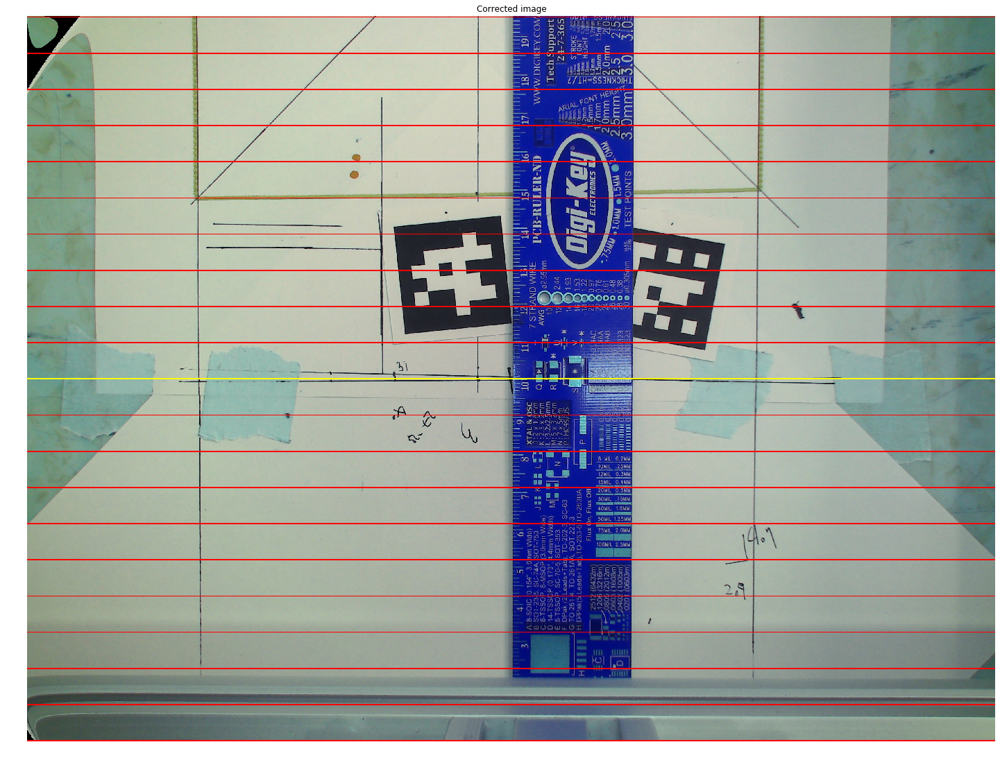

In [21]:
i=0 # select image id
plt.figure(figsize=(25,25))
frame = cv2.imread("n1.jpg")
img_undist = cv2.undistort(frame,mtx,dist,None)
gap = 122
for i in range(frame.shape[0]//2,frame.shape[0],gap):
    for j in range(frame.shape[1]):
        for k in range(4):
            img_undist[i+k][j] = [255,0,0]
for i in range(frame.shape[0]//2,0,-gap):
    for j in range(frame.shape[1]):
        for k in range(4):
            img_undist[i+k][j] = [255,0,0]
for j in range(frame.shape[1]):
    for k in range(4):
        img_undist[frame.shape[0]//2+k][j] = [255,255,0]
plt.imshow(img_undist)
plt.title("Corrected image")
plt.axis("off")
plt.show()

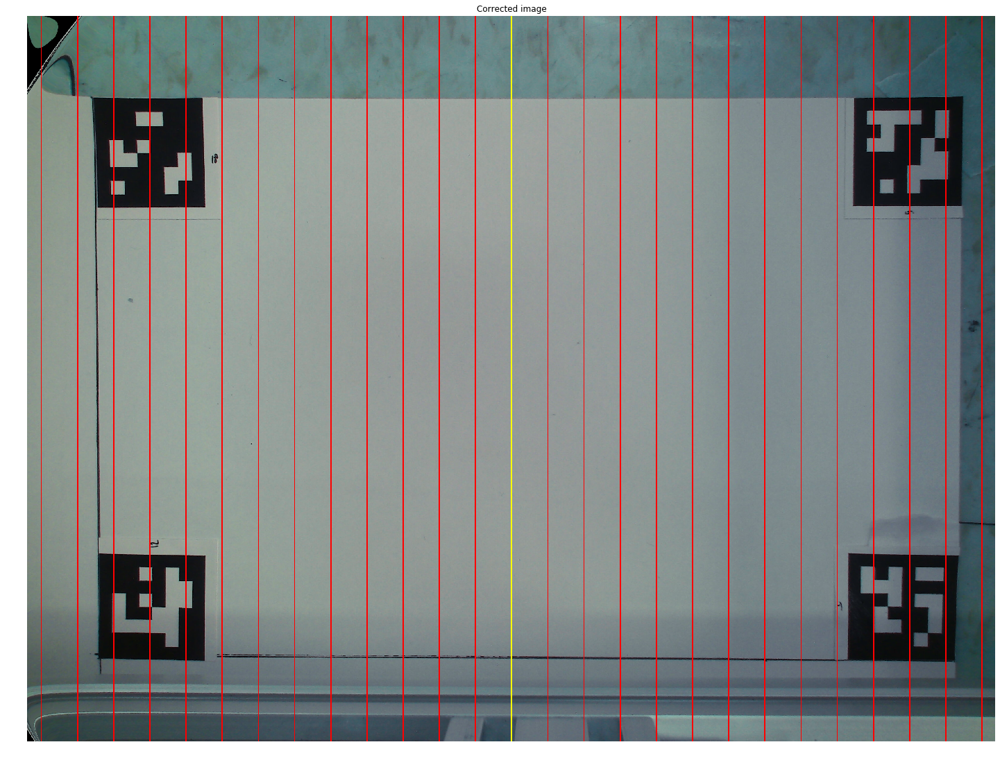

In [25]:
i=0 # select image id
plt.figure(figsize=(25,25))
frame = cv2.imread("new1.jpg")
img_undist = cv2.undistort(frame,mtx,dist,None)
gap = 122
for i in range(frame.shape[1]//2,frame.shape[1],gap):
    for j in range(frame.shape[0]):
        for k in range(4):
            img_undist[j][i+k] = [255,0,0]
for i in range(frame.shape[1]//2,0,-gap):
    for j in range(frame.shape[0]):
        for k in range(4):
            img_undist[j][i+k] = [255,0,0]
for j in range(frame.shape[0]):
    for k in range(4):
        img_undist[j][frame.shape[1]//2+k] = [255,255,0]
plt.imshow(img_undist)
plt.title("Corrected image")
plt.axis("off")
plt.show()

# i=0 # select image id
plt.figure(figsize=(25,25))

plt.imshow(img_undist)
plt.title("Corrected image")
# plt.axis("off")
plt.show()

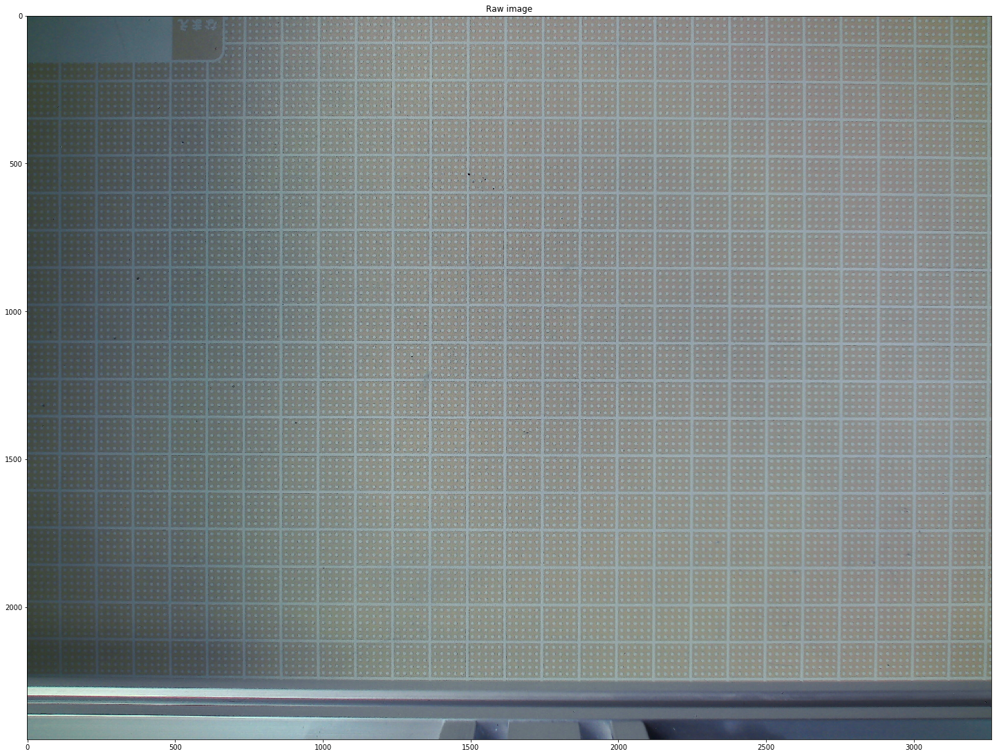

In [98]:
i=0 # select image id
plt.figure(figsize=(25,25))
# frame = cv2.imread("b.jpg")
# img_undist = cv2.undistort(frame,mtx,dist,None)
# plt.subplot(1,2,1)
plt.imshow(frame)
plt.title("Raw image")
plt.show()

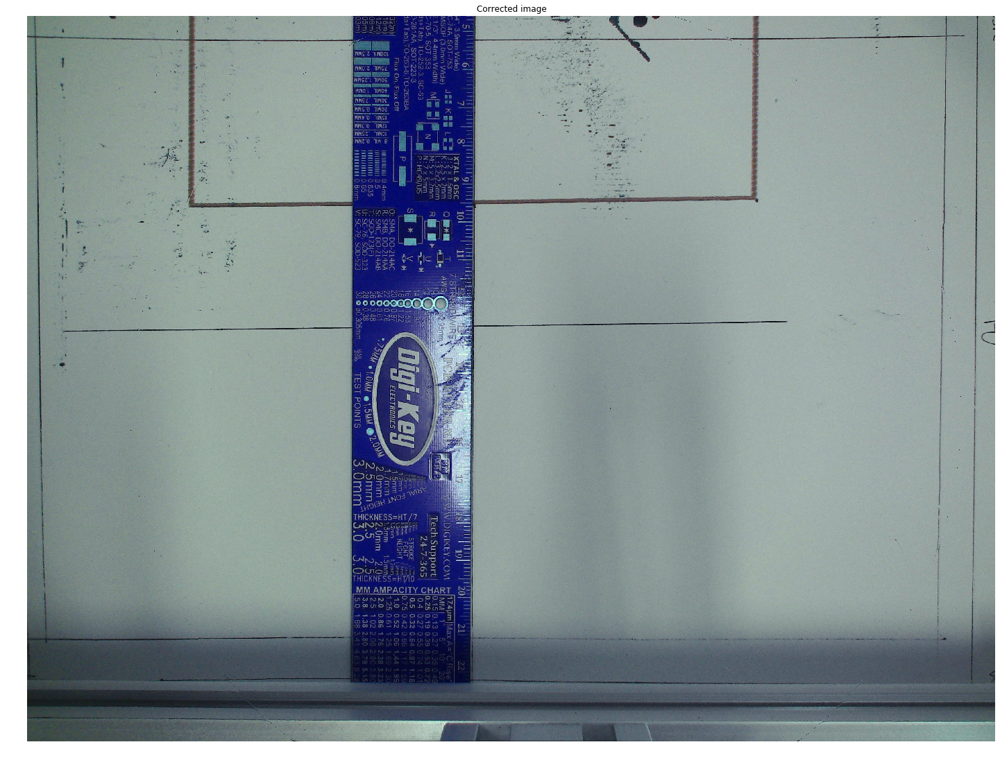

In [66]:
i=0 # select image id
plt.figure(figsize=(25,25))
frame = cv2.imread("../printer/test/camera1.jpg")
img_undist = cv2.undistort(frame,mtx,dist,None)

plt.imshow(img_undist)
plt.title("Corrected image")
plt.axis("off")
plt.show()

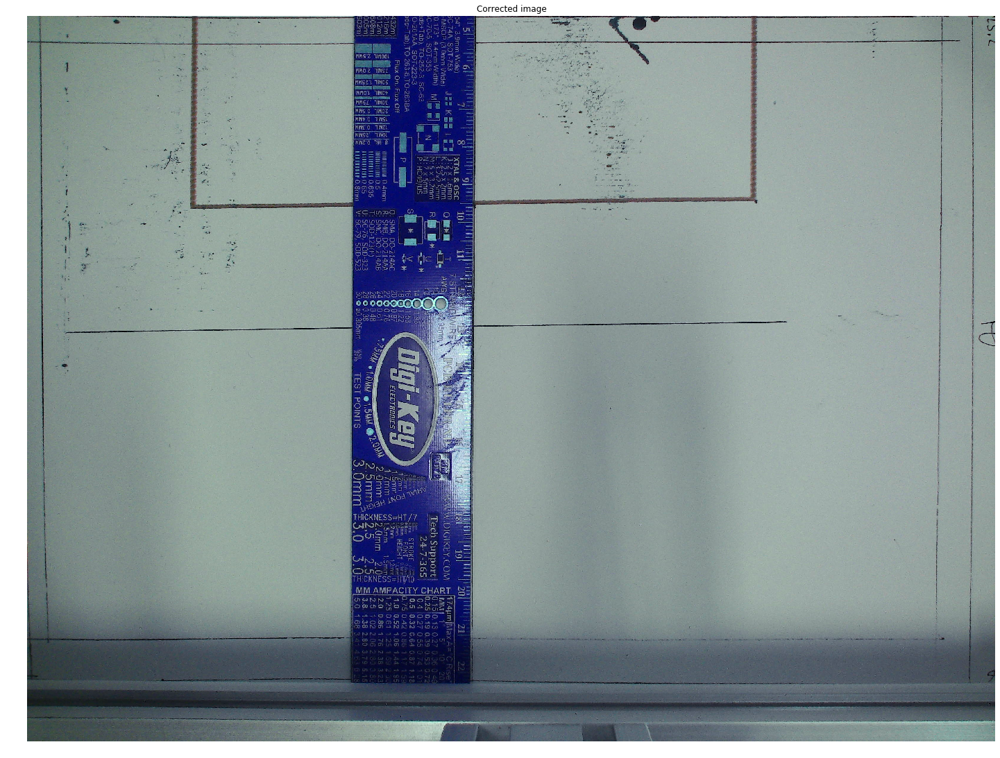

In [68]:
plt.figure(figsize=(25,25))
plt.imshow(frame)
plt.title("Corrected image")
plt.axis("off")
plt.show()

In [69]:
frame.shape

(2448, 3264, 3)

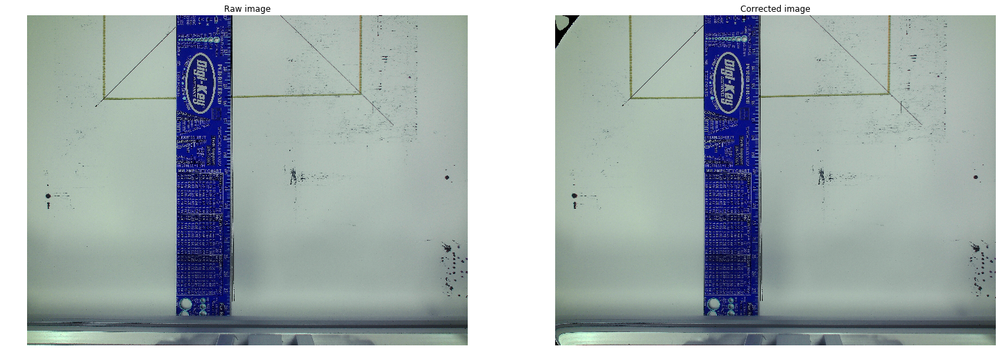

In [99]:
i=0 # select image id
plt.figure(figsize=(25,25))
frame = cv2.imread("c.jpg")
img_undist = cv2.undistort(frame,mtx,dist,None)
plt.subplot(1,2,1)
plt.imshow(frame)
plt.title("Raw image")
plt.axis("off")
plt.subplot(1,2,2)
plt.imshow(img_undist)
plt.title("Corrected image")
plt.axis("off")
plt.show()

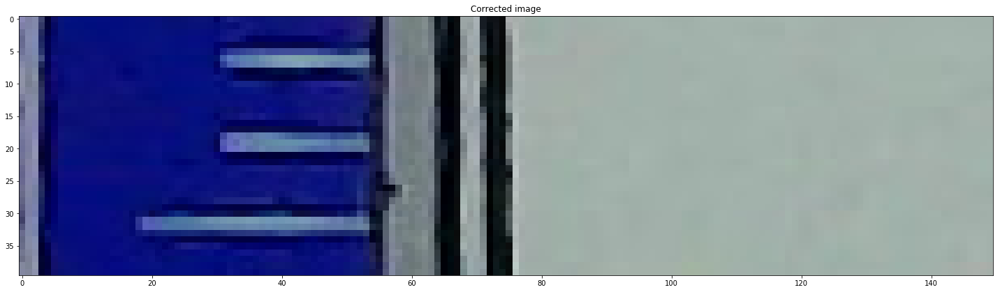

In [107]:
#1224
plt.figure(figsize=(25,25))
plt.imshow(img_undist[1210:1250,1450:1600])
plt.title("Corrected image")
# plt.axis("off")
plt.show()

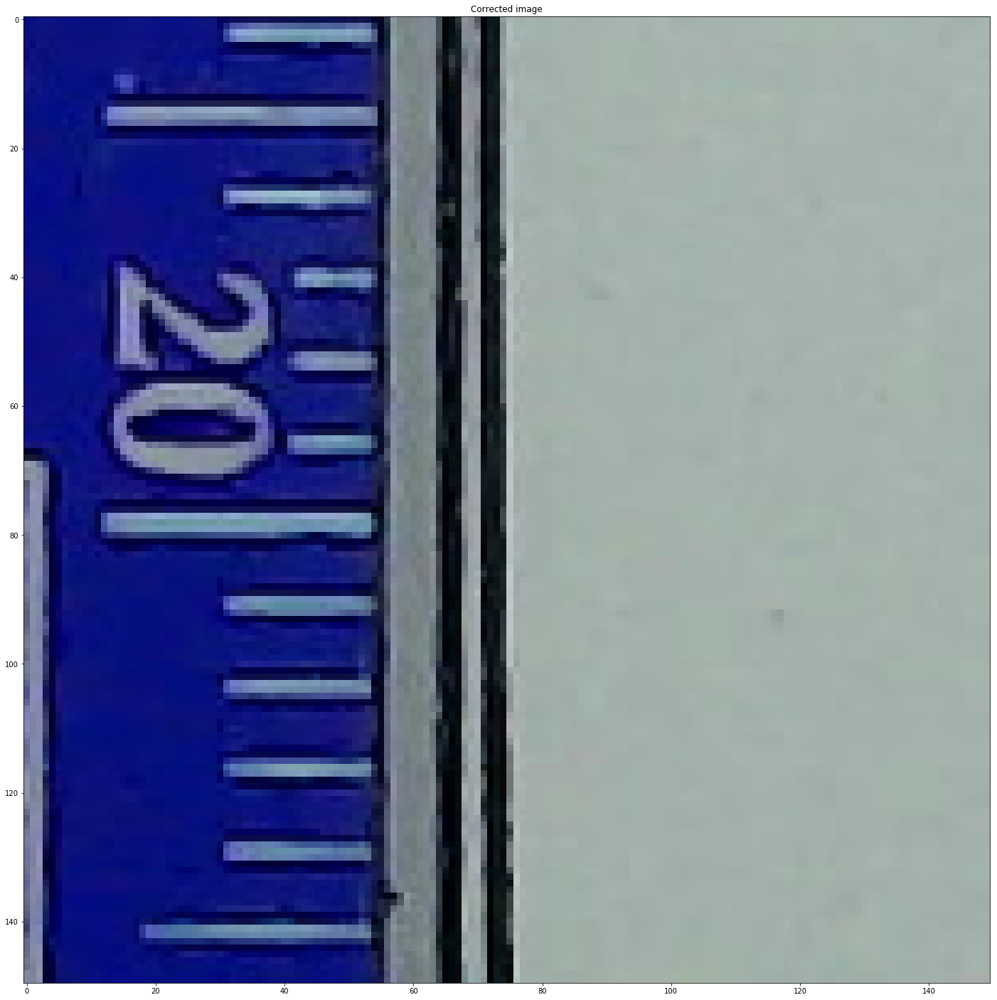

In [105]:
#1224
plt.figure(figsize=(25,25))
plt.imshow(img_undist[1100:1250,1450:1600])
plt.title("Corrected image")
# plt.axis("off")
plt.show()

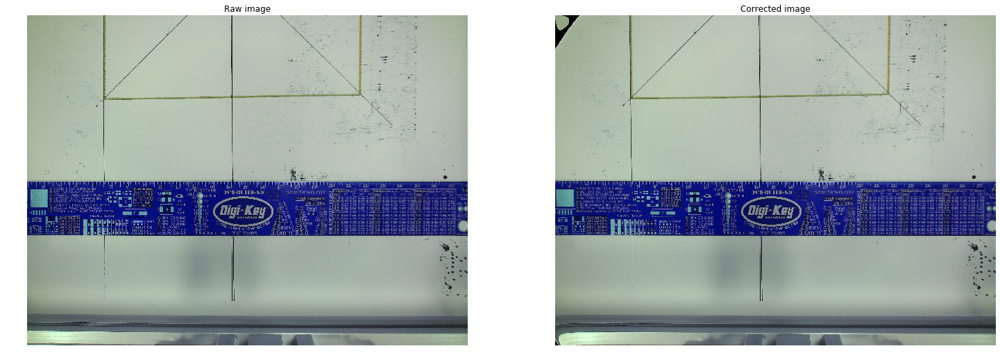

In [108]:
i=0 # select image id
plt.figure(figsize=(25,25))
frame = cv2.imread("d.jpg")
img_undist = cv2.undistort(frame,mtx,dist,None)
plt.subplot(1,2,1)
plt.imshow(frame)
plt.title("Raw image")
plt.axis("off")
plt.subplot(1,2,2)
plt.imshow(img_undist)
plt.title("Corrected image")
plt.axis("off")
plt.show()

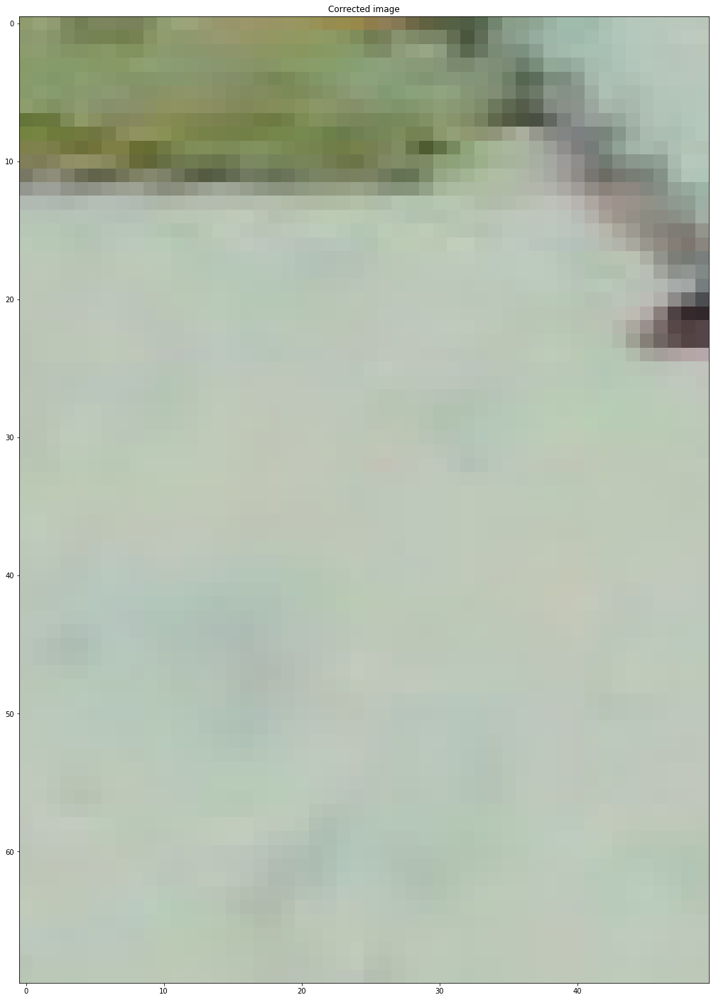

In [131]:
#(2448, 3264, 3) -> 1632
plt.figure(figsize=(25,25))
plt.imshow(img_undist[580:650,2440:2490])
plt.title("Corrected image")
# plt.axis("off")
plt.show()

In [ ]:
#620 559, 591,2469

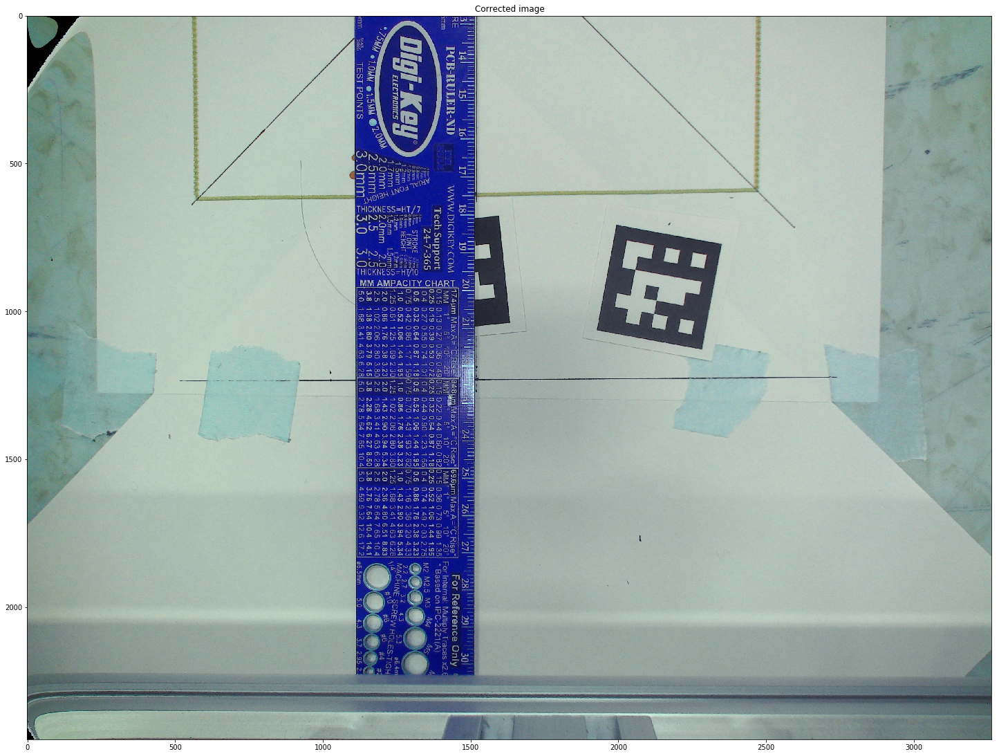

In [26]:
i=0 # select image id
plt.figure(figsize=(25,25))
frame = cv2.imread("f.jpg")
img_undist = cv2.undistort(frame,mtx,dist,None)
plt.imshow(img_undist)
plt.title("Corrected image")
# plt.axis("off")
plt.show()

In [27]:
W = 2105
H = 1300
pts1 = np.float32([[327., 491.],[2997.,  529.],[2955., 2168.],[ 323., 2127.]])
pts2 = np.float32([[0,0],[W,0],[W,H],[0,H]])

M = cv2.getPerspectiveTransform(pts1,pts2)

dst2 = cv2.warpPerspective(img_undist,M,(W,H))

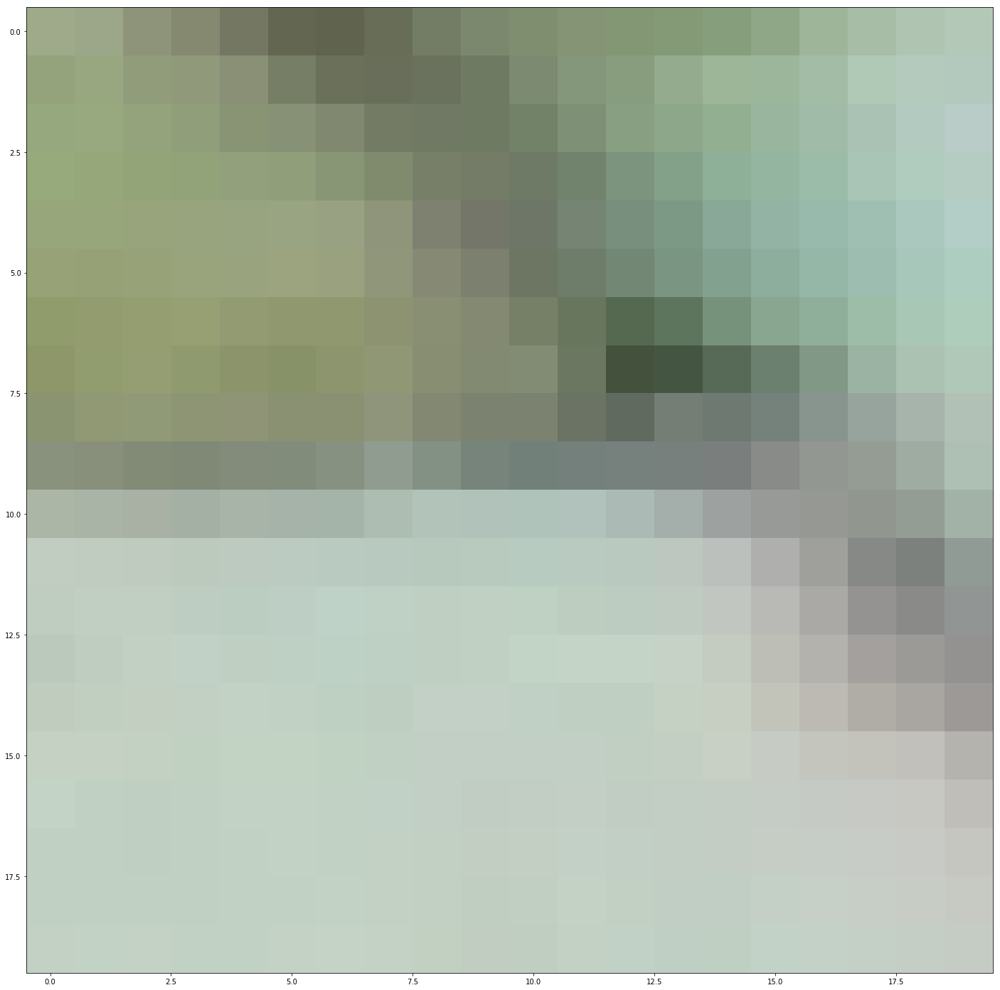

In [36]:
plt.figure(figsize=(25,25))
plt.imshow(dst2[50:70,1680:1700])
plt.show()
#562,1037

#line 103,196 -> 58,1691  45, 1495

In [136]:
#17.5 2229

In [176]:
def divline(p1,p2,ratio): #ratio in (0,1) close to p1
    [y1,x1] = p1
    [y2,x2] = p2
    rratio = 1-ratio
    x = int(x1*rratio + x2*ratio)
    y = int(y1*rratio + y2*ratio)
    return [y,x]
def drawline(p1,p2,pic,color=[255,0,0]):
    [y1,x1] = p1
    [y2,x2] = p2
    #y = mx + c
    if x1==x2:
        for i in range(pic.shape[0]):
            pic[i,int(x1)] = np.array(color,dtype="uint8")
        return
    if y1==y2:
        for i in range(pic.shape[1]):
            pic[int(y1),i] = np.array(color,dtype="uint8")
        return
    m = (y1-y2)/(x1-x2)
    c = y1-m*x1
#      = -c/m 
#     lastx = (pic.shape[0]-1-c)/m
    if abs(m) <= 1:
        for i in range(pic.shape[1]):
            yy = int(m*i+c)
            if yy < 0 or yy >= pic.shape[0]:
                continue
            for k1 in range(-2,3):
                for k2 in range(-2,3):
                    if 0 <= yy+k1 and yy+k1 < pic.shape[0] and 0 <= i+k2 and i+k2 < pic.shape[1]:
                        pic[yy,i] = np.array(color,dtype="uint8")
    else:
        for i in range(pic.shape[0]):
            xx = int((i-c)/m)
            if xx < 0 or xx >= pic.shape[1]:
                continue
            for k1 in range(-2,3):
                for k2 in range(-2,3):
                    if 0 <= i+k1 and i+k1 < pic.shape[0] and 0 <= xx+k2 and xx+k2 < pic.shape[1]:
                        pic[i,xx] = np.array(color,dtype="uint8")

In [179]:
frame.shape

(2448, 3264, 3)

In [180]:
tl = [0,0]
tr = [0,3263]
bl = [2229,0]
br = [2229,3263]

In [201]:
est_l = []
est_r = []
est_u = []
est_d = []
for i in range(49):
    est_l.append(divline(tl,bl,1-(i+1)*0.5/17.5))
    est_r.append(divline(tr,br,1-(i+1)*0.5/17.5))
    est_u.append(divline(tl,tr,1-(i+1)*0.5/26.0))
    est_d.append(divline(bl,br,1-(i+1)*0.5/26.0))
est_l = np.array(est_l)*ratio
est_r = np.array(est_r)*ratio
est_u = np.array(est_u)*ratio
est_d = np.array(est_d)*ratio
for i in range(est_l.shape[0]):
    est_l[i][0] = int(est_l[i][0])
    est_l[i][1] = int(est_l[i][1])
for i in range(est_l.shape[0]):
    est_r[i][0] = int(est_r[i][0])
    est_r[i][1] = int(est_r[i][1])
for i in range(est_u.shape[0]):
    est_u[i][0] = int(est_u[i][0])
    est_u[i][1] = int(est_u[i][1])
    est_d[i][0] = int(est_d[i][0])
    est_d[i][1] = int(est_d[i][1])

In [62]:
est_l

NameError: name 'est_l' is not defined

In [202]:
ratio = 0.25
small = cv2.resize(frame, (0,0), fx=ratio, fy=ratio)

In [203]:
for i in range(len(est_l)):
#     print(est_l[i],est_r[i])
#     drawline(est_l[i],est_r[i],small,[0,255,0])
    drawline(est_u[i],est_d[i],small,[0,255,0])

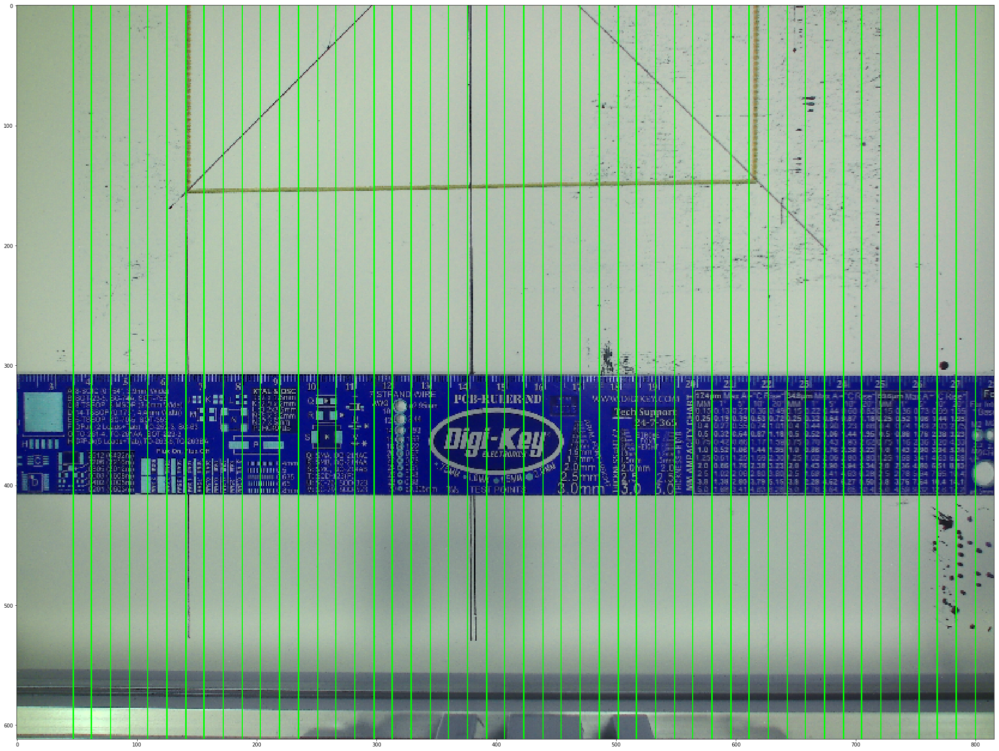

In [204]:
plt.figure(figsize=(35,35))
plt.imshow(small)
plt.show()

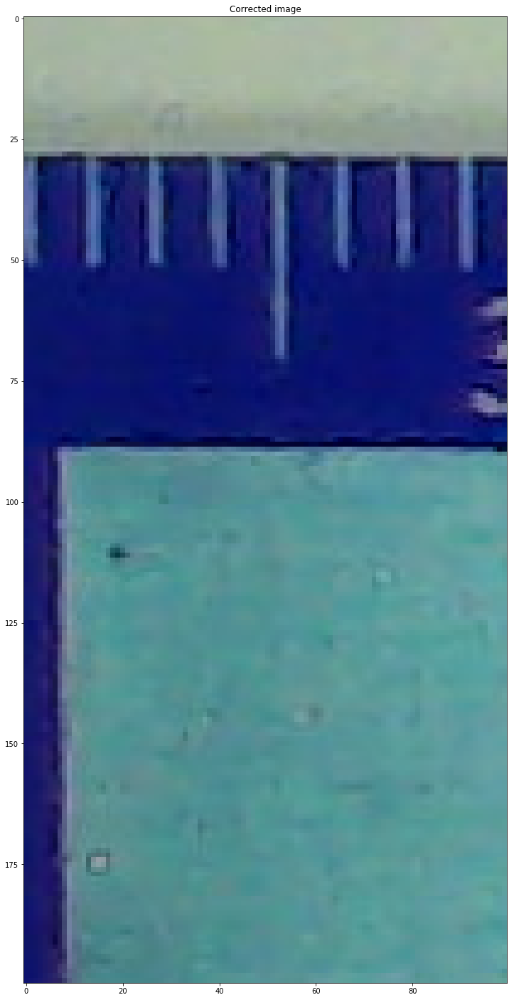

In [195]:
i=0 # select image id
plt.figure(figsize=(25,25))
frame = cv2.imread("d.jpg")
img_undist = cv2.undistort(frame,mtx,dist,None)
plt.imshow(img_undist[1200:1400,0:100])
plt.title("Corrected image")
# plt.axis("off")
plt.show()

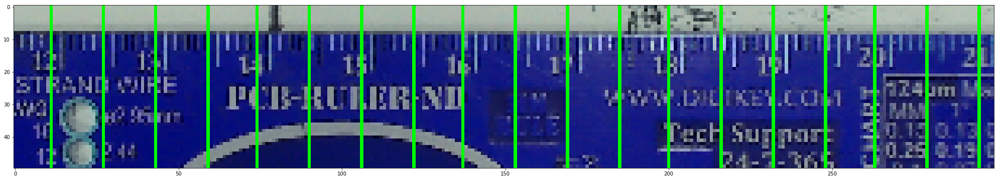

In [200]:
plt.figure(figsize=(35,35))
plt.imshow(small[300:350,300:600])
plt.show()

(2448, 3264, 3)


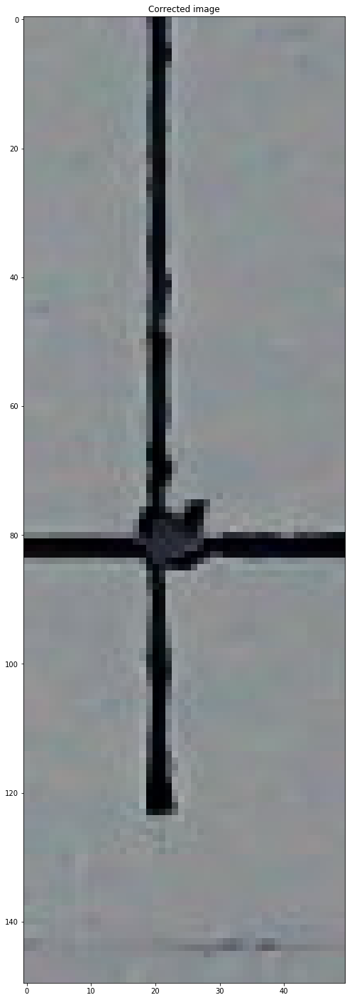

In [48]:

plt.figure(figsize=(25,25))
frame = cv2.imread("e.jpg")
print(frame.shape)
img_undist = cv2.undistort(frame,mtx,dist,None)
plt.imshow(img_undist[1150:1300,1500:1550])
plt.title("Corrected image")
# plt.axis("off")
plt.show()

(2448, 3264, 3)


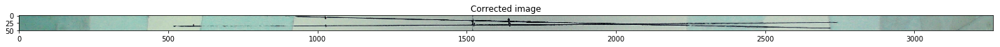

In [55]:

plt.figure(figsize=(25,25))
frame = cv2.imread("g.jpg")
print(frame.shape)
img_undist = cv2.undistort(frame,mtx,dist,None)
plt.imshow(img_undist[1200:1250,:])
plt.title("Corrected image")
# plt.axis("off")
plt.show()

In [41]:
ret, frame = cap.read()
# print(frame.shape)

In [42]:
frame

In [56]:
frame = cv2.imread('g.jpg')
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
aruco_dict = aruco.Dictionary_get(aruco.DICT_6X6_250)
parameters =  aruco.DetectorParameters_create()
corners, ids, rejectedImgPoints = aruco.detectMarkers(gray, aruco_dict, parameters=parameters)
frame_markers = aruco.drawDetectedMarkers(frame.copy(), corners, ids)

In [69]:
ids

array([[ 4],
       [16]], dtype=int32)

In [60]:
frame.shape

(2448, 3264, 3)

In [61]:
3264/2 - 1996 #-2.90

-364.0

In [63]:
2448/2 - 715 #3.99

509.0

In [64]:
3264/2 - 1244 #3.09

388.0

In [65]:
2448/2-722 #3.94

502.0

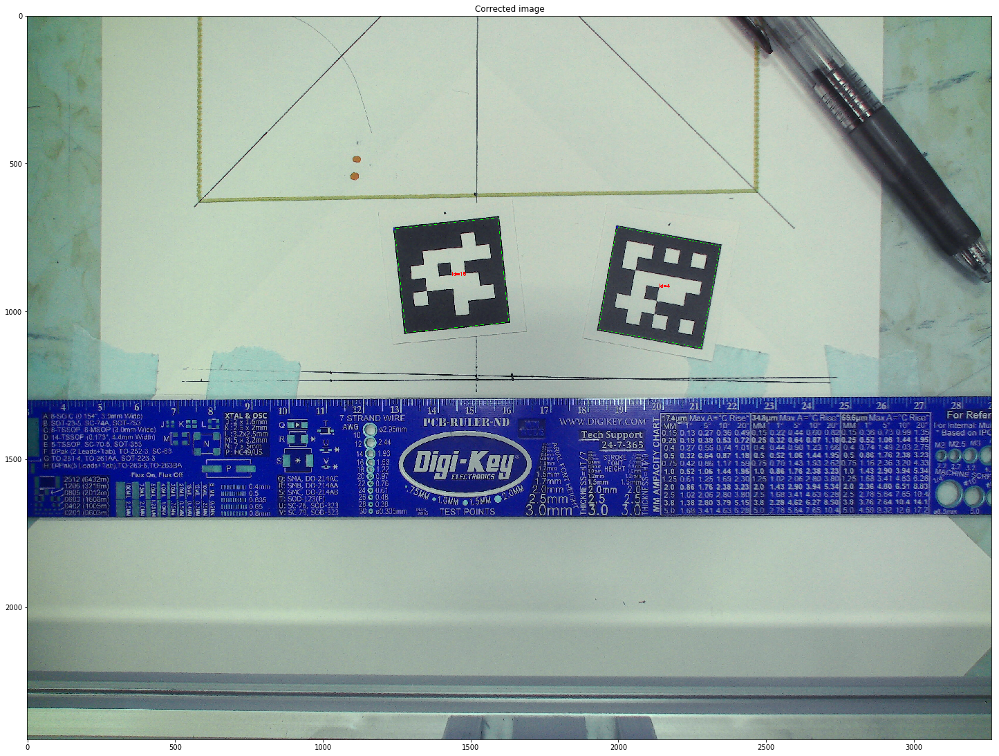

In [68]:

plt.figure(figsize=(25,25))
plt.imshow(frame_markers)
plt.title("Corrected image")
# plt.axis("off")
plt.show()